# Geospatial Big Data Analytics

## 6th Project

### Pavlos Kalfantis - MSc Data Science and Machine Learning

# GET DATA FROM TORCHGEO

In [ ]:
#Download python packages
!pip install torchgeo
!pip install rasterio
!pip install pytorch-lightning
!pip install radiant-mlhub #Needed for api key for torchgeo
!pip install matplotlib==3.5.2

In [ ]:
import matplotlib
print(matplotlib.__version__)  #Earlier versions do not work correctly - check version

3.5.2


In [ ]:
#Import libraries

import rasterio 
from glob import glob
import os
import numpy as np
import matplotlib.pyplot as plt
from rasterio.plot import show
import json
from osgeo import gdal, osr, ogr
from typing import Callable, List

from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, confusion_matrix

import torch
from torchgeo.datasets import SpaceNet1
from torchvision.transforms import ToTensor
from torch.utils.data import Dataset, DataLoader, random_split, Subset
from torchvision.transforms import RandomHorizontalFlip
import pytorch_lightning as pl
import torch.nn.functional as F
from torch import nn
from torch.optim import Adam
from torchmetrics import Accuracy, ConfusionMatrix, Dice, F1Score, JaccardIndex
from torchsummary import summary
from torchvision.transforms import functional as Fv
from pytorch_lightning.callbacks import EarlyStopping, ModelCheckpoint

plt.rcParams["figure.figsize"] = (10,10) #Standard image size plotting

In [ ]:
#Download data

# get api key from radiant-mlhub and download from torchgeo 
API_KEY = 'c517f90cf723a0c648e39ebc35ff8ca2be41781caae071cf86412dbb9b4a184b'
data = SpaceNet1(root = 'data', download = True, api_key = API_KEY)

# DATA EXPLORATION

(3, 406, 439)


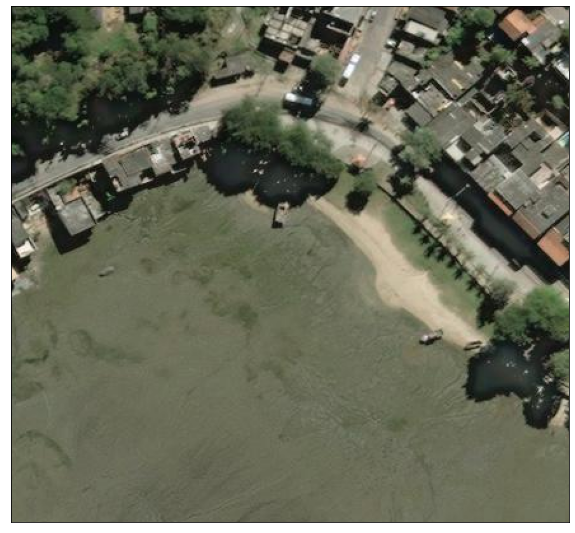

In [ ]:
#Plot random image

raster_file = '/content/data/sn1_AOI_1_RIO/sn1_AOI_1_RIO_img1445/RGB.tif'
geojson_file = '/content/data/sn1_AOI_1_RIO/sn1_AOI_1_RIO_img1445-labels/labels.geojson'

with rasterio.open(raster_file) as dataset:
    image = dataset.read().astype(np.int16)
print(image.shape)

pimage = np.transpose(image, (1, 2, 0))

ax = plt.gca()
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.imshow(pimage)

In [ ]:
import pprint

with open(geojson_file) as f:
        geojson_data = json.load(f)

pprint.pprint(geojson_data)

{'crs': {'properties': {'name': 'urn:ogc:def:crs:OGC:1.3:CRS84'},
         'type': 'name'},
 'features': [{'geometry': {'coordinates': [[[-43.69487929999997,
                                              -22.984465499999942,
                                              0.0],
                                             [-43.69493559999995,
                                              -22.984406699999965,
                                              0.0],
                                             [-43.694879399999934,
                                              -22.984365499999967,
                                              0.0],
                                             [-43.694828,
                                              -22.98442369999998,
                                              0.0],
                                             [-43.69487929999997,
                                              -22.984465499999942,
                                           

In [ ]:
#Helper funtcion to convert latiture and longitude to pixels

def latLonToPixel(lat, lon, input_raster='', targetsr='', geomTransform=''):
    """docstring for latLonToPixel"""
    sourcesr = osr.SpatialReference()
    sourcesr.ImportFromEPSG(4326)

    geom = ogr.Geometry(ogr.wkbPoint)
    geom.AddPoint(lon, lat)

    if targetsr == '':
        src_raster = gdal.Open(input_raster)
        targetsr = osr.SpatialReference()
        targetsr.ImportFromWkt(src_raster.GetProjectionRef())
    coordTrans = osr.CoordinateTransformation(sourcesr, targetsr)
    if geomTransform == '':
        src_raster = gdal.Open(input_raster)
        transform = src_raster.GetGeoTransform()
    else:
        transform = geomTransform

    xOrigin = transform[0]
    yOrigin = transform[3]
    pixelWidth = transform[1]
    pixelHeight = transform[5]
    geom.Transform(coordTrans)
    xPix = (geom.GetPoint()[0] - xOrigin) / pixelWidth
    yPix = (geom.GetPoint()[1] - yOrigin) / pixelHeight

    return (xPix, yPix)


In [ ]:
def geojson_to_pixel_arr(raster_file, geojson_file, pixel_ints=True):
    '''
    Tranform geojson file into array of points in pixel (and latlon) coords
    pixel_ints = 1 sets pixel coords as integers
    '''
    
    # load geojson file
    with open(geojson_file) as f:
        geojson_data = json.load(f)

    # load raster file and get geo transforms
    src_raster = gdal.Open(raster_file)
    targetsr = osr.SpatialReference()
    targetsr.ImportFromWkt(src_raster.GetProjectionRef())
        
    geom_transform = src_raster.GetGeoTransform()
    
    # get latlon coords
    latlons = []
    types = []
    for feature in geojson_data['features']:
        coords_tmp = feature['geometry']['coordinates'][0]
        type_tmp = feature['geometry']['type']

        latlons.append(coords_tmp)
        types.append(type_tmp)
    
    # convert latlons to pixel coords
    pixel_coords = []
    latlon_coords = []
    for i, (poly_type, poly0) in enumerate(zip(types, latlons)):
        
        if poly_type.upper() == 'MULTIPOLYGON':
            #print "oops, multipolygon"
            for poly in poly0:
                poly=np.array(poly)

                # account for nested arrays
                if len(poly.shape) == 3 and poly.shape[0] == 1:
                    poly = poly[0]
                    
                poly_list_pix = []
                poly_list_latlon = []

                for coord in poly:
                    lon, lat, z = coord 
                    px, py = latLonToPixel(lat, lon, input_raster=src_raster,
                                         targetsr=targetsr, 
                                         geomTransform=geom_transform)
                    poly_list_pix.append([px, py])
                    poly_list_latlon.append([lat, lon])
                
                if pixel_ints:
                    ptmp = np.rint(poly_list_pix).astype(int)
                else:
                    ptmp = poly_list_pix
                pixel_coords.append(ptmp)
                latlon_coords.append(poly_list_latlon)            

        elif poly_type.upper() == 'POLYGON':
            poly=np.array(poly0)
                
            # account for nested arrays
            if len(poly.shape) == 3 and poly.shape[0] == 1:
                poly = poly[0]
                
            poly_list_pix = []
            poly_list_latlon = []
            for coord in poly:
                lon, lat, z = coord 
                px, py = latLonToPixel(lat, lon, input_raster=src_raster,
                                     targetsr=targetsr, 
                                     geomTransform=geom_transform)
                poly_list_pix.append([px, py])
                poly_list_latlon.append([lat, lon])
            
            if pixel_ints:
                ptmp = np.rint(poly_list_pix).astype(int)
            else:
                ptmp = poly_list_pix
            pixel_coords.append(ptmp)
            latlon_coords.append(poly_list_latlon)
            
        else:
            print ("Unknown shape type in coords_arr_from_geojson()")
            return
            
    return pixel_coords#, latlon_coords

In [ ]:
#Calculate pixel coords for polygons

pixel_coords = geojson_to_pixel_arr(raster_file, geojson_file)



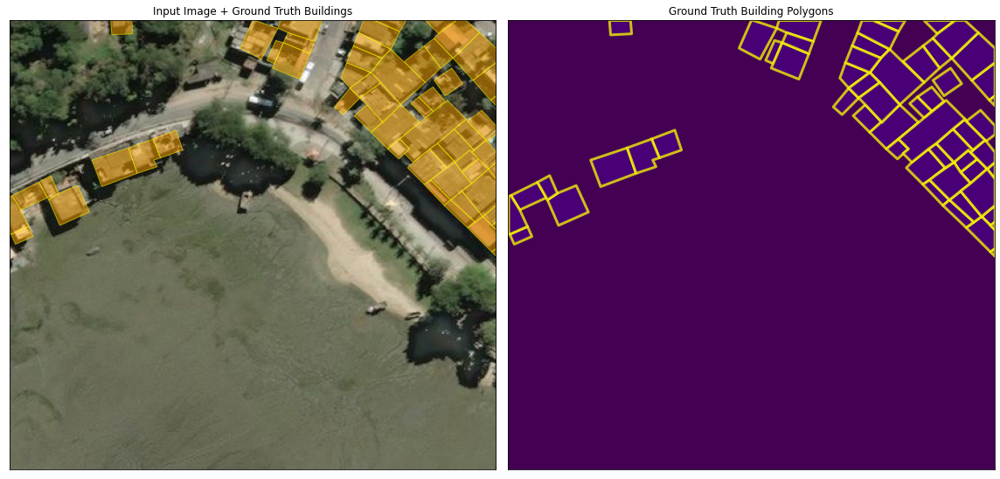

In [ ]:
from matplotlib.collections import PatchCollection
from matplotlib.patches import Polygon

###############################################################################
def plot_truth_coords(input_image, pixel_coords,   
                  figsize=(8,8), poly_face_color='orange', 
                  poly_edge_color='yellow', poly_nofill_color='indigo', cmap='viridis'):
    '''Plot ground truth coordinaates, pixel_coords should be a numpy array'''
    
    fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(2*figsize[0], figsize[1]))

    # create patches
    patches = []
    patches_nofill = []
    if len(pixel_coords) > 0:
        # get patches    
        for coord in pixel_coords:
            patches_nofill.append(Polygon(coord, facecolor=poly_nofill_color, 
                                          edgecolor=poly_edge_color, lw=3))
            patches.append(Polygon(coord, edgecolor=poly_edge_color, fill=True, 
                                   facecolor=poly_face_color))
        p0 = PatchCollection(patches, alpha=0.50, match_original=True)
        p1 = PatchCollection(patches_nofill, alpha=0.75, match_original=True)
                   
    # ax0: raw image
    ax0.imshow(input_image)
    if len(patches) > 0:
        ax0.add_collection(p0)
    ax0.get_xaxis().set_visible(False)
    ax0.get_yaxis().set_visible(False)
    ax0.set_title('Input Image + Ground Truth Buildings') 
    
    # truth polygons
    zero_arr = np.zeros(input_image.shape[:2])
    # set background to white?
    #zero_arr[zero_arr == 0.0] = np.nan
    ax1.imshow(zero_arr, cmap=cmap)
    if len(patches) > 0:
        ax1.add_collection(p1)
    ax1.get_xaxis().set_visible(False)
    ax1.get_yaxis().set_visible(False)
    ax1.set_title('Ground Truth Building Polygons')
        
    #plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    return patches, patches_nofill

patches, patches_nofill = plot_truth_coords(pimage,pixel_coords)

In [ ]:
DATA_ROOT = "/content/data/sn1_AOI_1_RIO/"

label_files = sorted(glob(os.path.join(DATA_ROOT, "**/labels.geojson"), recursive=True))
rgb_files = sorted(glob(os.path.join(DATA_ROOT, "**/RGB.tif"), recursive=True))


In [ ]:
def create_building_mask(rasterSrc, vectorSrc, npDistFileName='', 
                            noDataValue=0, burn_values=1):
    '''
    Create building mask for rasterSrc,
    Similar to labeltools/createNPPixArray() in spacenet utilities
    '''
    
    ## open source vector file that truth data
    source_ds = ogr.Open(vectorSrc)
    source_layer = source_ds.GetLayer()

    ## extract data from src Raster File to be emulated
    ## open raster file that is to be emulated
    srcRas_ds = gdal.Open(rasterSrc)
    cols = srcRas_ds.RasterXSize
    rows = srcRas_ds.RasterYSize

    ## create First raster memory layer, units are pixels
    # Change output to geotiff instead of memory 
    memdrv = gdal.GetDriverByName('GTiff') 
    dst_ds = memdrv.Create(npDistFileName, cols, rows, 1, gdal.GDT_Byte, 
                           options=['COMPRESS=LZW'])
    dst_ds.SetGeoTransform(srcRas_ds.GetGeoTransform())
    dst_ds.SetProjection(srcRas_ds.GetProjection())
    band = dst_ds.GetRasterBand(1)
    band.SetNoDataValue(noDataValue)    
    gdal.RasterizeLayer(dst_ds, [1], source_layer, burn_values=[burn_values])
    dst_ds = 0
    with rasterio.open(npDistFileName) as dataset:
      mask = dataset.read().astype(np.int16)
      mask = np.squeeze(mask,axis=0)
    return torch.from_numpy(mask)

In [ ]:
mask = create_building_mask(raster_file, geojson_file, npDistFileName='test.tif', 
                            noDataValue=0, burn_values=1)

In [ ]:
def plot_building_mask(input_image, pixel_coords, mask_image,   
                  figsize=(8,8), poly_face_color='orange', 
                  poly_edge_color='yellow', poly_nofill_color='indigo', cmap='viridis'):

    fig, (ax0, ax1, ax2) = plt.subplots(1, 3, 
                                        figsize=(3*figsize[0], figsize[1]))
    # create patches
    patches = []
    patches_nofill = []
    if len(pixel_coords) > 0:
        # get patches    
        for coord in pixel_coords:
            patches_nofill.append(Polygon(coord, facecolor=poly_nofill_color, 
                                          edgecolor=poly_edge_color, lw=3))
            patches.append(Polygon(coord, edgecolor=poly_edge_color, fill=True, 
                                   facecolor=poly_face_color))
        p0 = PatchCollection(patches, alpha=0.50, match_original=True)
        p1 = PatchCollection(patches_nofill, alpha=0.75, match_original=True)              
 
    # ax0: raw image
    ax0.imshow(input_image)
    if len(patches) > 0:
        ax0.add_collection(p0)
    ax0.get_xaxis().set_visible(False)
    ax0.get_yaxis().set_visible(False)
    ax0.set_title('Input Image + Ground Truth Buildings', fontsize='20') 
    
    # truth polygons
    zero_arr = np.zeros(input_image.shape[:2])
    # set background to white?
    #zero_arr[zero_arr == 0.0] = np.nan
    ax1.imshow(zero_arr, cmap=cmap)
    if len(patches) > 0:
        ax1.add_collection(p1)
    ax1.get_xaxis().set_visible(False)
    ax1.get_yaxis().set_visible(False)
    ax1.set_title('Ground Truth Building Polygons', fontsize='20')
        
  
    # mask
    ax2.imshow(mask_image)#, cmap=cmap)
    ax2.get_xaxis().set_visible(False)
    ax2.get_yaxis().set_visible(False)
    ax2.set_title('Ground Truth Building Mask', fontsize='20')    
          
    #plt.axis('off')
    plt.tight_layout()
    plt.show()
    
    return

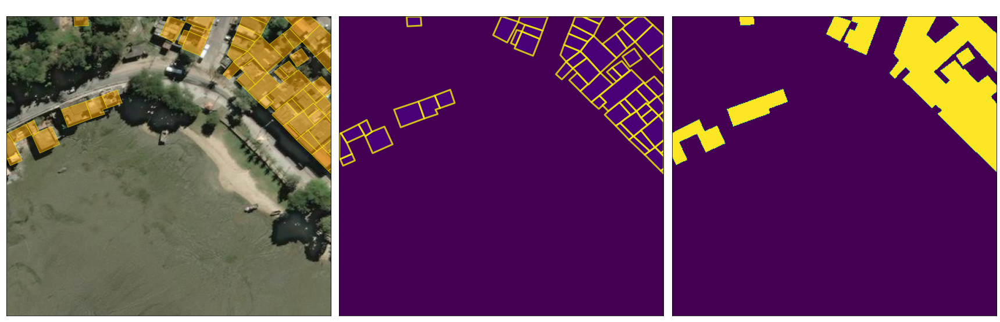

In [ ]:
matplotlib.rcParams['text.color'] = 'w'
plot_building_mask(pimage, pixel_coords, mask)

In [ ]:
print('Number of all files is:',len(glob(os.path.join("/content/data/sn1_AOI_1_RIO/", "**/labels.geojson"), recursive=True)))

Number of all files is: 6940


# BUILD TORCH DATASET

In [ ]:
from torch.utils.data import Dataset, DataLoader, random_split, Subset
from typing import Callable, List
import random

TransformFun = Callable[[dict], dict]

class spacenet_dset(Dataset):    
    def __init__(self, data_root, dset_size, transforms: List[TransformFun] = []):
        super().__init__()
        #self.px = img_size #Pixels to extract for square training samples
        self.dset_size = dset_size
        self._build_db(data_root)
        self.transforms = transforms
        
    def _build_db(self, data_root) -> None:
      
        all_label_files = sorted(glob(os.path.join(DATA_ROOT, "**/labels.geojson"), recursive=True))
        all_rgb_files = sorted(glob(os.path.join(DATA_ROOT, "**/RGB.tif"), recursive=True))
        self.rgb_files = []
        self.label_files = []

        for i in range(len(all_label_files)):
          raster_file = all_rgb_files[i]
          geojson_file = all_label_files[i]
          with open(geojson_file) as f:
                geojson_data = json.load(f)
          if len(geojson_data['features'])>0:
            self.rgb_files.append(raster_file)
            self.label_files.append(geojson_file)

        self.indices = random.sample([i for i in range(len(self.label_files))], 
                                            self.dset_size)
    
    def __getitem__(self, index):
        raster_file = self.rgb_files[self.indices[index]]
        geojson_file = self.label_files[self.indices[index]]

        with rasterio.open(raster_file) as dataset:
            image = dataset.read().astype(np.float32)/255
        
        img = torch.from_numpy(image)
        mask = create_building_mask(raster_file, geojson_file, npDistFileName='test.tif', 
                            noDataValue=0, burn_values=1)
        
        #img = img[:,:self.px,:self.px]
        #mask = mask[:self.px,:self.px]
        # 400x400 or 400x432
        img = img[:,:400,:400] #All images same size and dividable 4 times by 2
        mask = mask[:400,:400] 
        for T in self.transforms:
            img = T(img)
        return img, mask.float() 
    
    def append_transform(self, t: TransformFun) -> None:
        self.transforms.append(t)
    
    def __len__(self) -> int:
        #return len(self.label_files)
        return len(self.indices)

In [ ]:
DATA_ROOT = "/content/data/sn1_AOI_1_RIO/"

dset = spacenet_dset(DATA_ROOT,1000)
print(len(dset))

1000


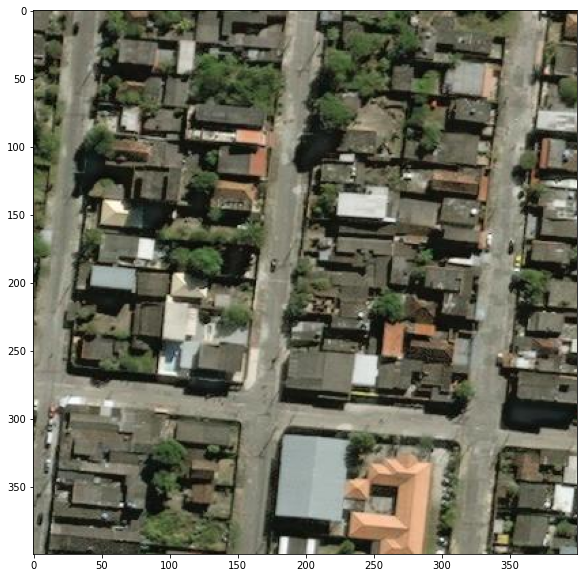

In [ ]:
plt.imshow(dset[100][0].permute(1,2,0))

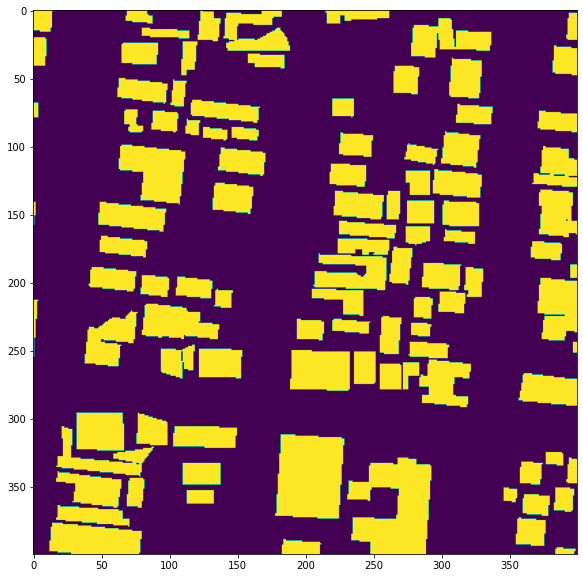

In [ ]:
plt.imshow(dset[100][1])

In [ ]:
train_dset, val_dset, test_dset = random_split(dset, 
        lengths=[
            int(0.7*len(dset)),
            int(0.2*len(dset)),
            len(dset) - int(0.7*len(dset)) - int(0.2*len(dset))
        ]
    )

train_dloader =DataLoader(train_dset, batch_size=8, shuffle=True, num_workers=0)
val_dloader =DataLoader(val_dset, batch_size=8, shuffle=False, num_workers=0)
test_dloader =DataLoader(test_dset, batch_size=8, shuffle=False, num_workers=0)
random_test_batch = next(iter(test_dloader)) #to plot results later

means = []
stds = []
for sample in train_dset:
    img = sample[0].reshape(3,-1)
    means.append(img.mean(dim=-1))
    stds.append(img.std(dim=-1))

mean = torch.stack(means).mean(dim=0)
std = torch.stack(stds).mean(dim=0)

def normalize(mean, std) -> TransformFun:
    def apply(x:dict) -> dict:
        x = Fv.normalize(x, mean=mean, std=std)
        return x
    return apply

dset.append_transform(normalize(mean=mean, std=std))
random_test_batch_norm = next(iter(test_dloader))
# train_dloader =DataLoader(train_dset, batch_size=8, shuffle=True, num_workers=0)
# val_dloader =DataLoader(val_dset, batch_size=8, shuffle=False, num_workers=0)
# test_dloader =DataLoader(test_dset, batch_size=8, shuffle=False, num_workers=0)

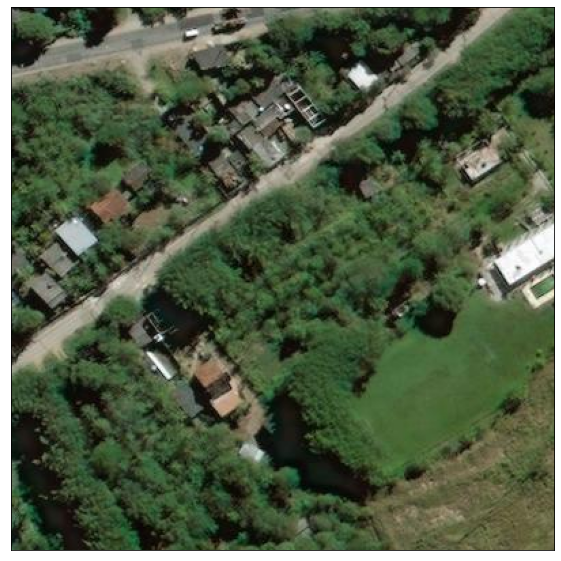

In [ ]:
ax = plt.gca()
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.imshow(random_test_batch[0][1,:,:,:].permute(1,2,0))

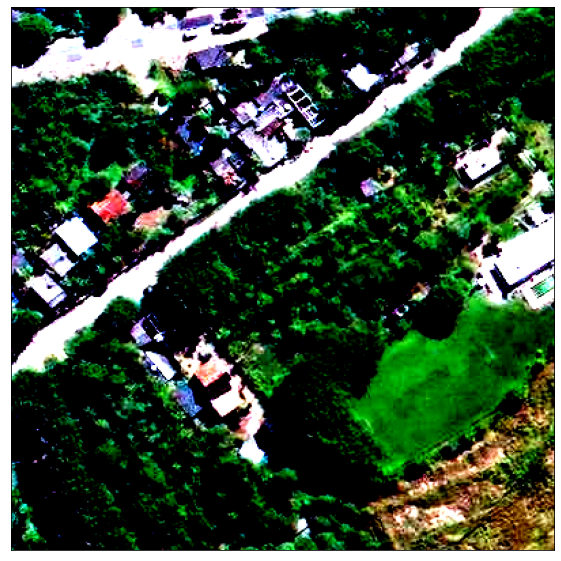

In [ ]:

ax = plt.gca()
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.imshow(random_test_batch_norm[0][1,:,:,:].permute(1,2,0))

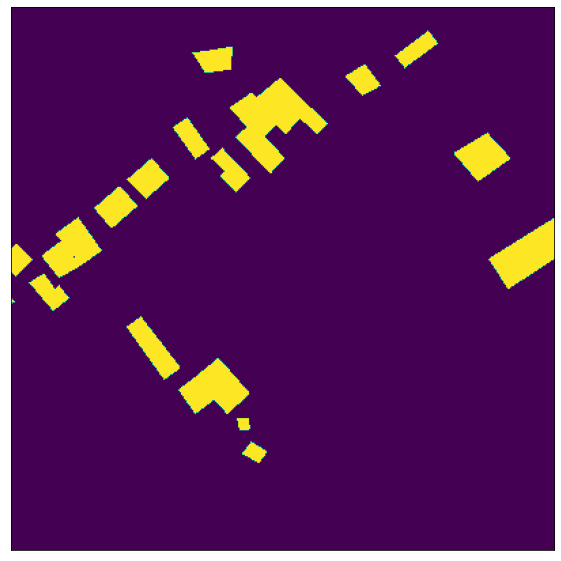

In [ ]:
ax = plt.gca()
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
plt.imshow(random_test_batch[1][1,:,:])

# UNET FOR SEMANTIC SEGMENTATION

In [ ]:
from torch import Tensor
def dice_coeff(input: Tensor, target: Tensor, reduce_batch_first: bool = False, epsilon=1e-6):
    # Average of Dice coefficient for all batches, or for a single mask
    assert input.size() == target.size()
    if input.dim() == 2 and reduce_batch_first:
        raise ValueError(f'Dice: asked to reduce batch but got tensor without batch dimension (shape {input.shape})')

    if input.dim() == 2 or reduce_batch_first:
        inter = torch.dot(input.reshape(-1), target.reshape(-1))
        sets_sum = torch.sum(input) + torch.sum(target)
        if sets_sum.item() == 0:
            sets_sum = 2 * inter

        return (2 * inter + epsilon) / (sets_sum + epsilon)
    else:
        # compute and average metric for each batch element
        dice = 0
        for i in range(input.shape[0]):
            dice += dice_coeff(input[i, ...], target[i, ...])
        return dice / input.shape[0]

def dice_loss(input: Tensor, target: Tensor):
    # Dice loss (objective to minimize) between 0 and 1
    assert input.size() == target.size()
    return 1 - dice_coeff(input, target, reduce_batch_first=True)

In [ ]:
class Unet(pl.LightningModule):
    def __init__(self, n_channels, n_classes):
        super(Unet, self).__init__()

        self.n_channels = n_channels
        self.n_classes = n_classes
        self.pixel_accuracy = Accuracy()

        def double_conv(in_channels, out_channels):
            return nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=3, padding='same'),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
                nn.Conv2d(out_channels, out_channels, kernel_size=3, padding='same'),
                nn.BatchNorm2d(out_channels),
                nn.ReLU(inplace=True),
            )

        def down(in_channels, out_channels):
            return nn.Sequential(
                nn.MaxPool2d(2),
                double_conv(in_channels, out_channels)
            )

        class up(nn.Module):
            def __init__(self, in_channels, out_channels):
                super().__init__()

                self.up = nn.ConvTranspose2d(in_channels ,#// 2,
                                                out_channels,
                                                kernel_size=2, stride=2)

                self.conv = double_conv(in_channels, out_channels)

            def forward(self, x1, x2):
                x1 = self.up(x1)
                # [?, C, H, W]
                diffY = x2.size()[2] - x1.size()[2]
                diffX = x2.size()[3] - x1.size()[3]

                x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                                diffY // 2, diffY - diffY // 2])
                x = torch.cat([x2, x1], dim=1) ## why 1?
                return self.conv(x)

        self.inc = double_conv(self.n_channels, 64)
        self.down1 = down(64, 128)
        self.down2 = down(128, 256)
        self.down3 = down(256, 512)
        self.down4 = down(512, 1024)
        self.up1 = up(1024, 512)
        self.up2 = up(512, 256)
        self.up3 = up(256, 128)
        self.up4 = up(128, 64)
        self.out = nn.Conv2d(64, self.n_classes, kernel_size=1)

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        return self.out(x)

    def training_step(self, batch, batch_idx):
        im ,mask = batch
        
        preds = self.forward(im)
        mask = mask.unsqueeze(1)
        masks_pred = (torch.sigmoid(preds)>0.5).float()

        dl = dice_loss(masks_pred,mask)
        loss = F.binary_cross_entropy_with_logits(preds,mask) + dl

        self.log("loss/train", loss, on_step=False, on_epoch=True)
        
        return loss
    
    def validation_step(self, batch, batch_idx):
        im ,mask = batch
        
        preds = self.forward(im)
        mask = mask.unsqueeze(1)
        masks_pred = (torch.sigmoid(preds)>0.5).float()
        
        dl = dice_loss(masks_pred,mask)
        loss = F.binary_cross_entropy_with_logits(preds,mask) + dl
      
        self.log("loss/val", loss, on_step=False, on_epoch=True)

        self.pixel_accuracy(preds, mask.type(torch.long))
        self.log("px_acc/val", self.pixel_accuracy, on_step=False, on_epoch=True)

    def configure_optimizers(self):
       # return torch.optim.RMSprop(self.parameters(), lr=0.01, weight_decay=1e-8, momentum=0.9)
        return torch.optim.Adam(self.parameters(), lr=0.001)

In [ ]:
callbacks = [
    EarlyStopping(monitor="px_acc/val", mode="max", patience=5),
    ModelCheckpoint(monitor="px_acc/val", mode="max", save_last=True)
]

model = Unet(3,1)

trainer = pl.Trainer(
    accelerator="gpu", 
    devices=1,
    min_epochs=10,
    max_epochs=100,
    callbacks=callbacks,
    default_root_dir="unet"
)

trainer.fit(model, train_dataloaders=train_dloader, val_dataloaders=val_dloader)

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:IPU available: False, using: 0 IPUs
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
   | Name           | Type       | Params
-----------------------------------------------
0  | pixel_accuracy | Accuracy   | 0     
1  | inc            | Sequential | 39.0 K
2  | down1          | Sequential | 221 K 
3  | down2          | Sequential | 886 K 
4  | down3          | Sequential | 3.5 M 
5  | down4          | Sequential | 14.2 M
6  | up1            | up         | 9.2 M 
7  | up2            | up         | 2.3 M 
8  | up3            | up         | 574 K 
9  | up4            | up         | 143 K 
10 | out            | Conv2d     | 

Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir unet/lightning_logs

<IPython.core.display.Javascript object>

In [ ]:
#Save model
torch.save(model.state_dict(), '/content/unet6.pth')
 


In [ ]:
#Load model
model = Unet(3,1)
model.load_state_dict(torch.load('/content/unet6.pth'))  #Loading best model

<All keys matched successfully>

In [ ]:
#Evaluate model on Test Set

predictions_list = []
targets_list = []
model.eval()
for batch_sample in test_dloader:
    X = batch_sample[0].to(torch.device('cuda'))
    y = batch_sample[1]#.numpy()
    targets_list.append(y)
    # Infer with the model
    with torch.no_grad():
        out = model(X)
    probs = torch.sigmoid(out).squeeze()
    predictions_list.append(probs>0.6)

predictions = torch.concat(predictions_list, axis=0)
targets = torch.concat(targets_list, axis=0)

In [ ]:
t = targets.cpu().flatten().numpy()
p = predictions.cpu().flatten().numpy()

In [ ]:
#cutoff 0.5

print("Accuracy: ", accuracy_score(t,p))
print("Precision: ", precision_score(t,p))
print("Recall: ",  recall_score(t,p))
print("F1-score: ",  f1_score(t,p))
jaccard = JaccardIndex(num_classes=2)
print("IoU:", jaccard(targets,predictions.cpu()).item())


Accuracy:  0.9235985
Precision:  0.7395110456998663
Recall:  0.700275604734716
F1-score:  0.7193587252377506
IoU: 0.7385114431381226


In [ ]:
#cutoff 0.4

print("Accuracy: ", accuracy_score(t,p))
print("Precision: ", precision_score(t,p))
print("Recall: ",  recall_score(t,p))
print("F1-score: ",  f1_score(t,p))
jaccard = JaccardIndex(num_classes=2)
print("IoU:", jaccard(targets,predictions.cpu()).item())


Accuracy:  0.920309125
Precision:  0.6899173702485525
Recall:  0.7811861105225941
F1-score:  0.7327205381417842
IoU: 0.7443603277206421


In [ ]:
#cutoff 0.6

print("Accuracy: ", accuracy_score(t,p))
print("Precision: ", precision_score(t,p))
print("Recall: ",  recall_score(t,p))
print("F1-score: ",  f1_score(t,p))
jaccard = JaccardIndex(num_classes=2)
print("IoU:", jaccard(targets,predictions.cpu()).item())

Accuracy:  0.9217280625
Precision:  0.7871050491329227
Recall:  0.6034510039503643
F1-score:  0.6831502132697046
IoU: 0.7166454792022705


In [ ]:
#Infer for random batch for visualization

model.eval()
X = random_test_batch_norm[0]
y = random_test_batch_norm[1]

# Infer with the model
with torch.no_grad():
    out = model(X)
probs = torch.sigmoid(out).squeeze()
preds = probs>0.5

In [ ]:
def plot_predictions(img, gt_mask, pred,figsize=(8,8)):

    fig, (ax0, ax1, ax2) = plt.subplots(1, 3, 
                                        figsize=(3*figsize[0], figsize[1]))

    # raw image
    ax0.imshow(img)
    ax0.get_xaxis().set_visible(False)
    ax0.get_yaxis().set_visible(False)
    ax0.set_title('Input Image')
    
    # mask
    ax1.imshow(gt_mask)
    ax1.get_xaxis().set_visible(False)
    ax1.get_yaxis().set_visible(False)
    ax1.set_title('Ground Truth Building Mask')
  
    # prediction
    ax2.imshow(pred)
    ax2.get_xaxis().set_visible(False)
    ax2.get_yaxis().set_visible(False)
    ax2.set_title('Predicted Building Mask')    
          
    plt.tight_layout()
    plt.show()
    
    return

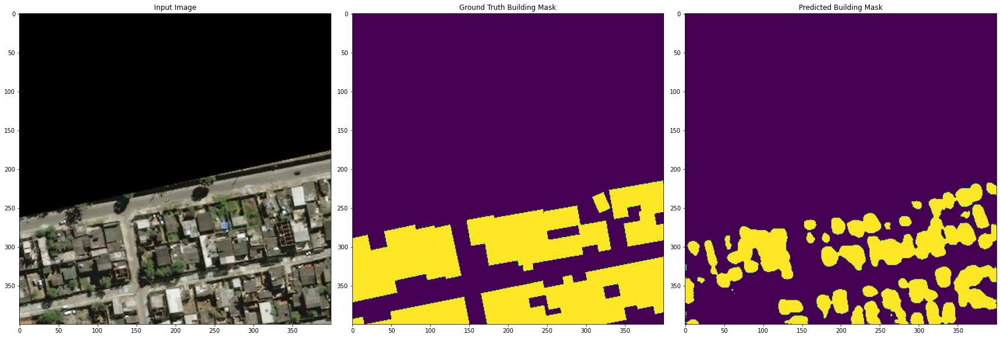

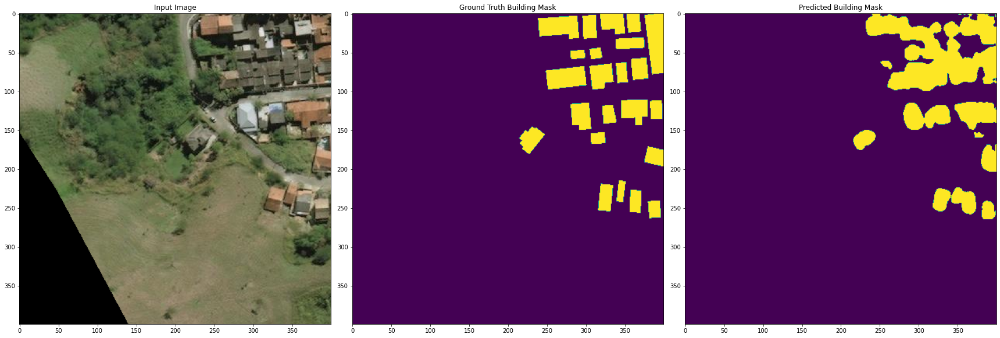

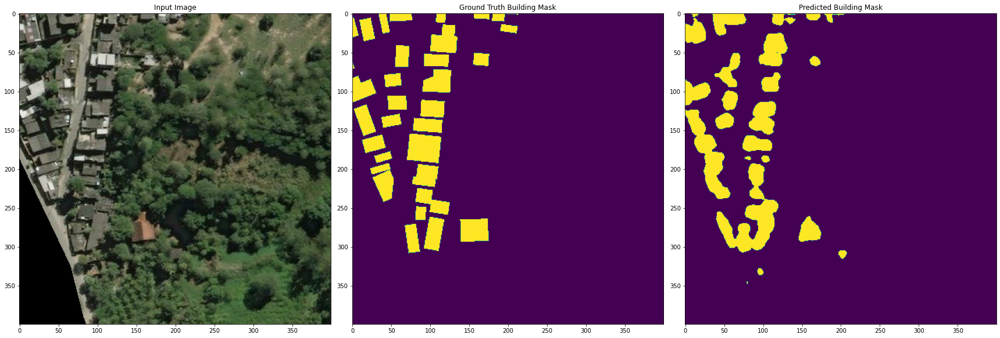

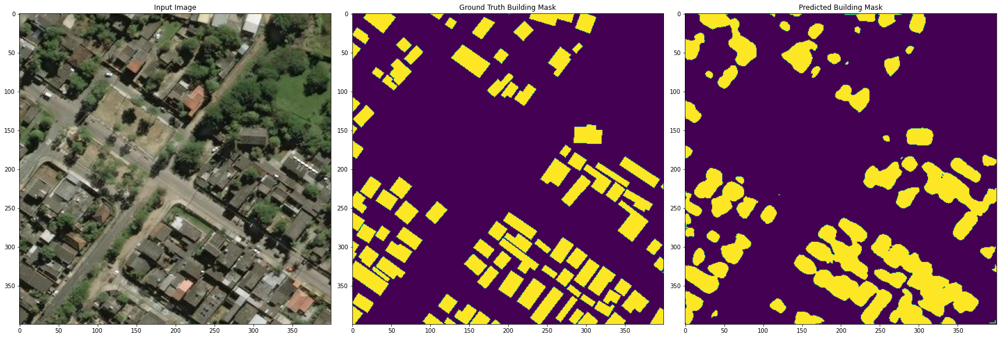

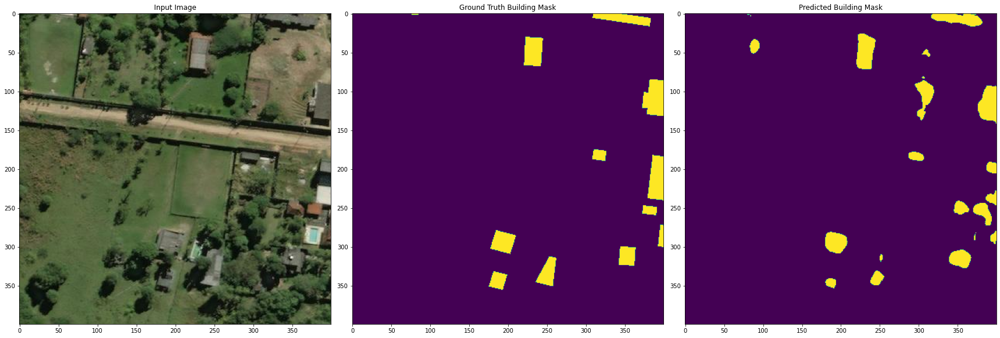

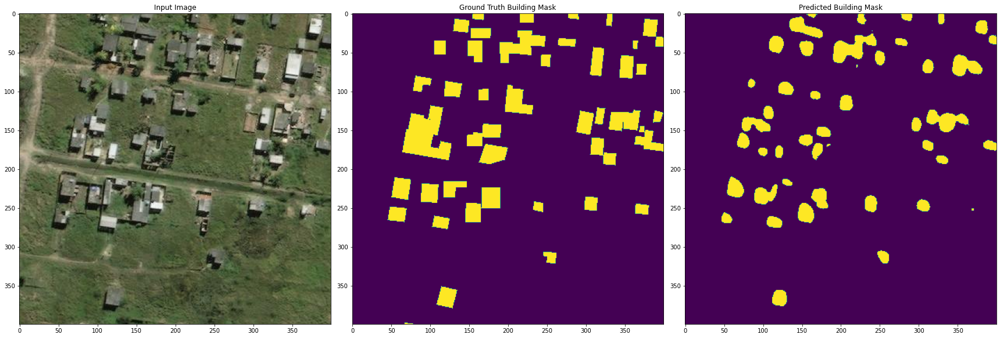

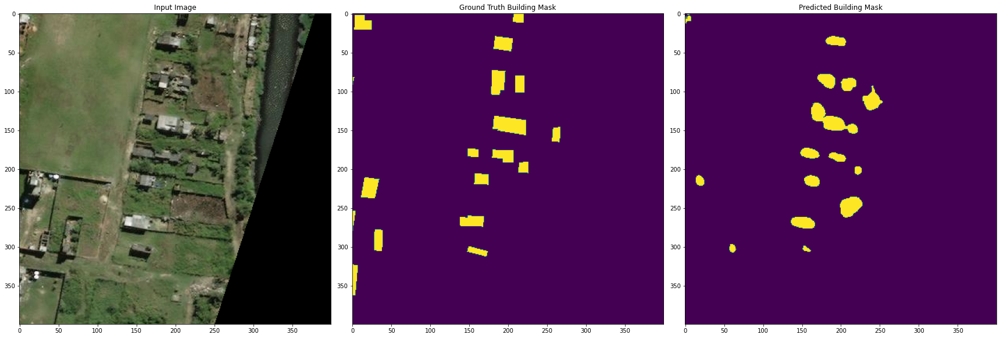

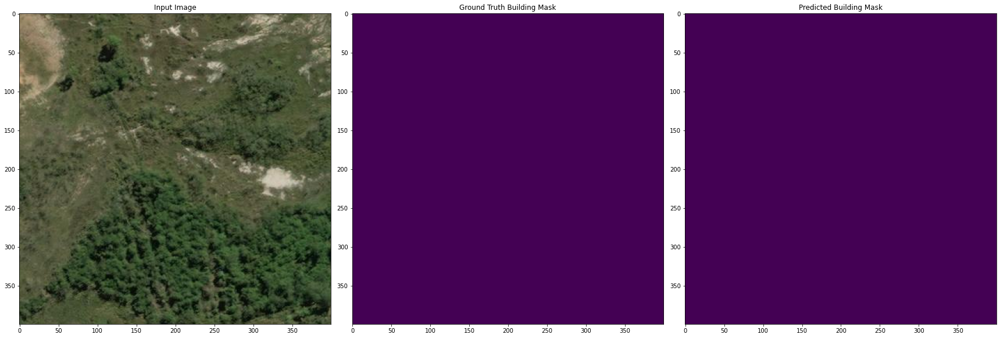

In [ ]:
for i in range(8):
  img = random_test_batch[0][i,:,:,:].permute(1,2,0)
  gt_mask = random_test_batch[1][i]
  pred = preds[i,:,:].squeeze()
  plot_predictions(img, gt_mask, pred)